In [1]:
import numpy as np
import sys
import os
sys.path.append(os.path.join(os.getcwd(), "src"))
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split
from sklearn.utils import check_random_state
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from ffnn import FFNN

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import f1_score, confusion_matrix, classification_report, log_loss, roc_auc_score, cohen_kappa_score, precision_recall_fscore_support

In [2]:
# Load data from https://www.openml.org/d/554
X, y = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)

In [3]:
print(X.shape)
print(y.shape) 

(70000, 784)
(70000,)


In [4]:
def validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder):
  # Precision, Recall, F1-Score (Weighted and Macro)
  precision, recall, f1, _ = precision_recall_fscore_support(
      y_val_encoded, y_val_pred, average='weighted')
  macro_f1 = f1_score(y_val_encoded, y_val_pred, average='macro')
  print(f"Weighted F1-Score: {f1:.4f}")
  print(f"Macro F1-Score: {macro_f1:.4f}")

  # Cohen's Kappa
  kappa = cohen_kappa_score(y_val_encoded, y_val_pred)
  print(f"Cohen's Kappa: {kappa:.4f}")

  # ROC-AUC (One-vs-Rest for Multi-Class)
  try:
      roc_auc = roc_auc_score(y_val_encoded, y_val_pred_proba, multi_class='ovr', average='weighted')
      print(f"ROC-AUC (Weighted): {roc_auc:.4f}")
  except ValueError:
      print("ROC-AUC could not be computed for this dataset.")

  # Log Loss
  logloss = log_loss(y_val_encoded, y_val_pred_proba)
  print(f"\nValidation Log Loss: {logloss:.4f}")


  # Classfication Report
  print("\nClassification Report:")
  print(classification_report(label_encoder.inverse_transform(y_val_encoded),
                              label_encoder.inverse_transform(y_val_pred),
                              target_names=[str(cls) for cls in label_encoder.classes_] ))

  # Confusion Matrix
  print()
  conf_matrix_id3 = confusion_matrix(label_encoder.inverse_transform(y_val_encoded),
                                    label_encoder.inverse_transform(y_val_pred),
                                    labels=label_encoder.classes_)

  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix_id3, annot=True, fmt='d', cmap='Blues',
              xticklabels=[str(cls) for cls in label_encoder.classes_], 
              yticklabels=[str(cls) for cls in label_encoder.classes_])
  plt.xlabel('Predicted Labels')
  plt.ylabel('True Labels')
  plt.title('Confusion Matrix')
  plt.show()

In [5]:
random_state = check_random_state(0)
permutation = random_state.permutation(X.shape[0])
X = X[permutation]
y = y[permutation]
X = X.reshape((X.shape[0], -1))

# one-hot encode labels
encoder = OneHotEncoder(sparse=False, categories='auto')
y_encoded = encoder.fit_transform(y.reshape(-1, 1))

# train-test split
X_train, X_val, y_train, y_val = train_test_split(X, y_encoded, test_size=0.2, random_state=42)


# Pengaruh Metode Inisialisasi Bobot

## 1. Zero Initialization

In [42]:
layer_sizes = [784, 150, 75, 10] 
activation_funcs = ["relu", "relu", "softmax"] 
model1 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="zero", loss_function="cce", seed=42)

# model training
history1 = model1.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 2.3025 - val_loss: 2.3024
Epoch 2/20 - loss: 2.3022 - val_loss: 2.3022
Epoch 3/20 - loss: 2.3020 - val_loss: 2.3021
Epoch 4/20 - loss: 2.3019 - val_loss: 2.3020
Epoch 5/20 - loss: 2.3017 - val_loss: 2.3019
Epoch 6/20 - loss: 2.3016 - val_loss: 2.3019
Epoch 7/20 - loss: 2.3015 - val_loss: 2.3018
Epoch 8/20 - loss: 2.3014 - val_loss: 2.3018
Epoch 9/20 - loss: 2.3014 - val_loss: 2.3017
Epoch 10/20 - loss: 2.3013 - val_loss: 2.3017
Epoch 11/20 - loss: 2.3013 - val_loss: 2.3017
Epoch 12/20 - loss: 2.3012 - val_loss: 2.3017
Epoch 13/20 - loss: 2.3012 - val_loss: 2.3017
Epoch 14/20 - loss: 2.3012 - val_loss: 2.3017
Epoch 15/20 - loss: 2.3011 - val_loss: 2.3017
Epoch 16/20 - loss: 2.3011 - val_loss: 2.3017
Epoch 17/20 - loss: 2.3011 - val_loss: 2.3017
Epoch 18/20 - loss: 2.3011 - val_loss: 2.3017
Epoch 19/20 - loss: 2.3011 - val_loss: 2.3017
Epoch 20/20 - loss: 2.3011 - val_loss: 2.3017


In [48]:
model1.visualize_gradient_weight_distribution()

In [43]:
model1.visualize_loss_curve()

In [44]:
predictions1 = model1.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels1 = np.argmax(predictions1, axis=1)
true_labels1 = np.argmax(y_val, axis=1)

In [46]:
label_encoder = LabelEncoder()
label_encoder.fit(np.arange(10))

y_val_encoded = np.argmax(y_val, axis=1)
y_val_pred1 = np.argmax(predictions1, axis=1) 
y_val_pred_proba1 = predictions1

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0222
Macro F1-Score: 0.0200
Cohen's Kappa: 0.0000
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 2.3017

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.11      1.00      0.20      1556
           2       0.00      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.00      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.11     14000
   macro avg       0.01      0.10      0.02     14000
weighted avg       0.01      0.11      0.02     14000




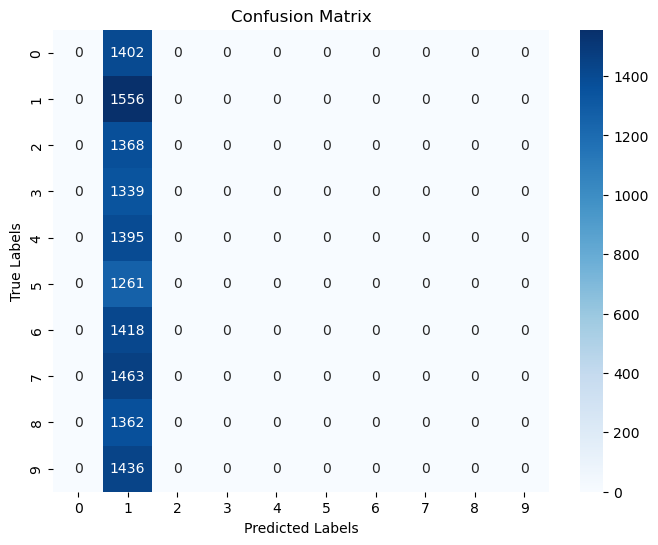

In [47]:
validate_model(model1, y_val_encoded, y_val_pred1, y_val_pred_proba1, label_encoder)

## 2. Random Uniform Initialization

In [6]:
layer_sizes = [784, 150, 75, 10] 
activation_funcs = ["relu", "relu", "softmax"] 
model = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="uniform", lower_bound=-0.5, upper_bound=0.5, loss_function="cce", seed=42)

# model training
history = model.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 2.9434 - val_loss: 2.3692
Epoch 2/20 - loss: 2.3313 - val_loss: 2.3437
Epoch 3/20 - loss: 2.2962 - val_loss: 2.3211
Epoch 4/20 - loss: 2.2580 - val_loss: 2.2839
Epoch 5/20 - loss: 2.2219 - val_loss: 2.2446
Epoch 6/20 - loss: 2.1898 - val_loss: 2.2203
Epoch 7/20 - loss: 2.1706 - val_loss: 2.2176
Epoch 8/20 - loss: 2.1566 - val_loss: 2.1905
Epoch 9/20 - loss: 2.1409 - val_loss: 2.1914
Epoch 10/20 - loss: 2.1253 - val_loss: 2.1720
Epoch 11/20 - loss: 2.1082 - val_loss: 2.1459
Epoch 12/20 - loss: 2.0934 - val_loss: 2.1418
Epoch 13/20 - loss: 2.0759 - val_loss: 2.1176
Epoch 14/20 - loss: 2.0541 - val_loss: 2.0803
Epoch 15/20 - loss: 2.0291 - val_loss: 2.0652
Epoch 16/20 - loss: 2.0087 - val_loss: 2.0549
Epoch 17/20 - loss: 1.9885 - val_loss: 2.0612
Epoch 18/20 - loss: 1.9770 - val_loss: 2.0215
Epoch 19/20 - loss: 1.9606 - val_loss: 2.0197
Epoch 20/20 - loss: 1.9388 - val_loss: 1.9861


In [7]:
#model.visualize_model()
model.visualize_weight_distribution()
model.visualize_gradient_weight_distribution()
model.visualize_loss_curve()

In [8]:
predictions = model.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels = np.argmax(predictions, axis=1)
true_labels = np.argmax(y_val, axis=1)

In [9]:
label_encoder = LabelEncoder()
label_encoder.fit(np.arange(10))

y_val_encoded = np.argmax(y_val, axis=1)
y_val_pred = np.argmax(predictions, axis=1) 
y_val_pred_proba = predictions

Weighted F1-Score: 0.2025
Macro F1-Score: 0.1897
Cohen's Kappa: 0.1742
ROC-AUC (Weighted): 0.6509

Validation Log Loss: 1.9861

Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.00      0.00      1402
           1       0.99      0.85      0.91      1556
           2       0.27      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.00      0.00      0.00      1395
           5       0.42      0.01      0.02      1261
           6       0.43      0.00      0.01      1418
           7       0.95      0.60      0.74      1463
           8       0.12      1.00      0.21      1362
           9       0.50      0.00      0.01      1436

    accuracy                           0.26     14000
   macro avg       0.42      0.25      0.19     14000
weighted avg       0.43      0.26      0.20     14000




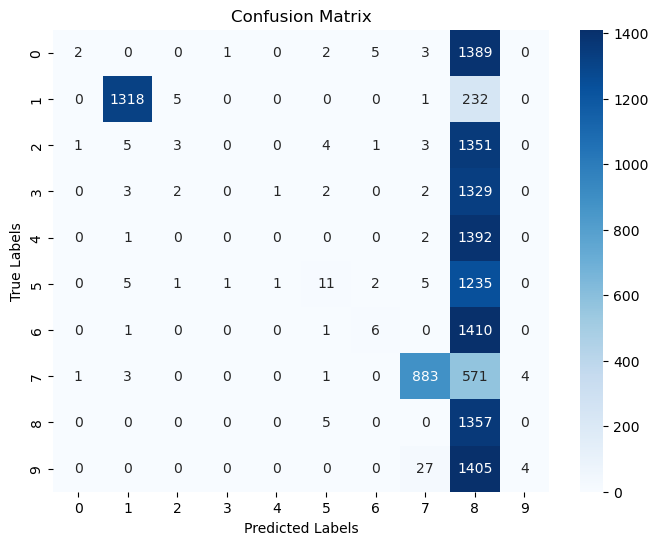

In [10]:
validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder)


## 3. Random Normal Initialization

In [13]:
layer_sizes = [784, 150, 75, 10] 
activation_funcs = ["relu", "relu", "softmax"] 
model3 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="normal", mean=0, variance=0.1, loss_function="cce", seed=42)

# model training
history3 = model3.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 2.7677 - val_loss: 2.3015
Epoch 2/20 - loss: 2.2249 - val_loss: 2.2079
Epoch 3/20 - loss: 2.1631 - val_loss: 2.1820
Epoch 4/20 - loss: 2.1409 - val_loss: 2.1659
Epoch 5/20 - loss: 2.1244 - val_loss: 2.1560
Epoch 6/20 - loss: 2.1116 - val_loss: 2.1514
Epoch 7/20 - loss: 2.1020 - val_loss: 2.1273
Epoch 8/20 - loss: 2.0949 - val_loss: 2.1310
Epoch 9/20 - loss: 2.0886 - val_loss: 2.1157
Epoch 10/20 - loss: 2.0770 - val_loss: 2.1059
Epoch 11/20 - loss: 2.0763 - val_loss: 2.1110
Epoch 12/20 - loss: 2.0692 - val_loss: 2.1075
Epoch 13/20 - loss: 2.0614 - val_loss: 2.1001
Epoch 14/20 - loss: 2.0577 - val_loss: 2.0978
Epoch 15/20 - loss: 2.0550 - val_loss: 2.0917
Epoch 16/20 - loss: 2.0492 - val_loss: 2.0930
Epoch 17/20 - loss: 2.0458 - val_loss: 2.0931
Epoch 18/20 - loss: 2.0420 - val_loss: 2.0832
Epoch 19/20 - loss: 2.0418 - val_loss: 2.0887
Epoch 20/20 - loss: 2.0356 - val_loss: 2.0882


In [14]:
model3.visualize_weight_distribution()
model3.visualize_gradient_weight_distribution()
model3.visualize_loss_curve()

In [15]:
predictions3 = model3.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels3 = np.argmax(predictions, axis=1)
true_labels3 = np.argmax(y_val, axis=1)

In [16]:
y_val_pred3 = np.argmax(predictions3, axis=1) 
y_val_pred_proba3 = predictions3

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.1230
Macro F1-Score: 0.1135
Cohen's Kappa: 0.1078
ROC-AUC (Weighted): 0.5984

Validation Log Loss: 2.0882

Classification Report:
              precision    recall  f1-score   support

           0       0.29      0.00      0.00      1402
           1       0.98      0.88      0.93      1556
           2       0.60      0.00      0.00      1368
           3       0.11      1.00      0.19      1339
           4       0.00      0.00      0.00      1395
           5       0.20      0.00      0.00      1261
           6       0.67      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.19     14000
   macro avg       0.28      0.19      0.11     14000
weighted avg       0.29      0.19      0.12     14000




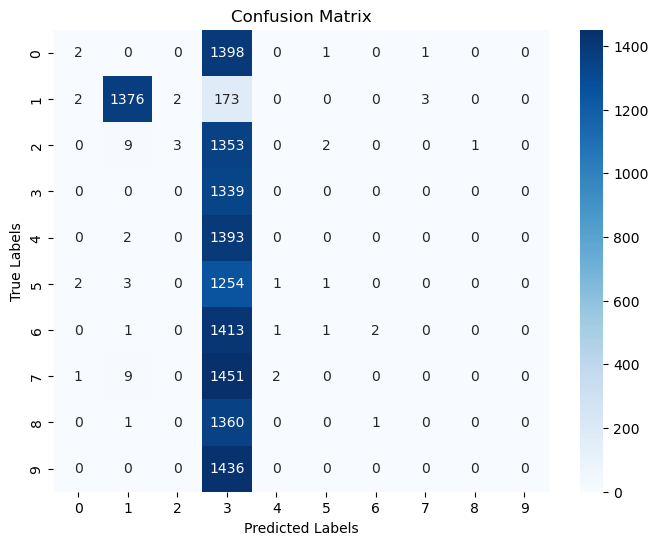

In [17]:
validate_model(model3, y_val_encoded, y_val_pred3, y_val_pred_proba3, label_encoder)

## 4. Normal Xavier Initialization

In [18]:
layer_sizes = [784, 150, 75, 10] 
activation_funcs = ["relu", "relu", "softmax"] 
model4 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="xavier", type="normal", loss_function="cce", seed=42)

# model training
history4 = model4.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 11.9375 - val_loss: 7.8297
Epoch 2/20 - loss: 7.4422 - val_loss: 7.0814
Epoch 3/20 - loss: 6.7224 - val_loss: 6.3959
Epoch 4/20 - loss: 6.0851 - val_loss: 5.8124
Epoch 5/20 - loss: 5.5640 - val_loss: 5.3535
Epoch 6/20 - loss: 5.1646 - val_loss: 5.0075
Epoch 7/20 - loss: 4.8630 - val_loss: 4.7431
Epoch 8/20 - loss: 4.6285 - val_loss: 4.5324
Epoch 9/20 - loss: 4.4376 - val_loss: 4.3568
Epoch 10/20 - loss: 4.2756 - val_loss: 4.2051
Epoch 11/20 - loss: 4.1338 - val_loss: 4.0705
Epoch 12/20 - loss: 4.0066 - val_loss: 3.9485
Epoch 13/20 - loss: 3.8903 - val_loss: 3.8362
Epoch 14/20 - loss: 3.7825 - val_loss: 3.7316
Epoch 15/20 - loss: 3.6814 - val_loss: 3.6331
Epoch 16/20 - loss: 3.5860 - val_loss: 3.5398
Epoch 17/20 - loss: 3.4952 - val_loss: 3.4509
Epoch 18/20 - loss: 3.4085 - val_loss: 3.3659
Epoch 19/20 - loss: 3.3256 - val_loss: 3.2846
Epoch 20/20 - loss: 3.2461 - val_loss: 3.2067


In [19]:
model4.visualize_weight_distribution()
model4.visualize_gradient_weight_distribution()
model4.visualize_loss_curve()

In [24]:
predictions4 = model4.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels4 = np.argmax(predictions4, axis=1)
true_labels4 = np.argmax(y_val, axis=1)

In [26]:
y_val_pred4 = np.argmax(predictions4, axis=1) 
y_val_pred_proba4 = predictions4

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\anton\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0167
Macro F1-Score: 0.0175
Cohen's Kappa: 0.0000
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 3.2067

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.00      0.00      0.00      1556
           2       0.00      0.00      0.00      1368
           3       0.10      1.00      0.17      1339
           4       0.00      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.10     14000
   macro avg       0.01      0.10      0.02     14000
weighted avg       0.01      0.10      0.02     14000




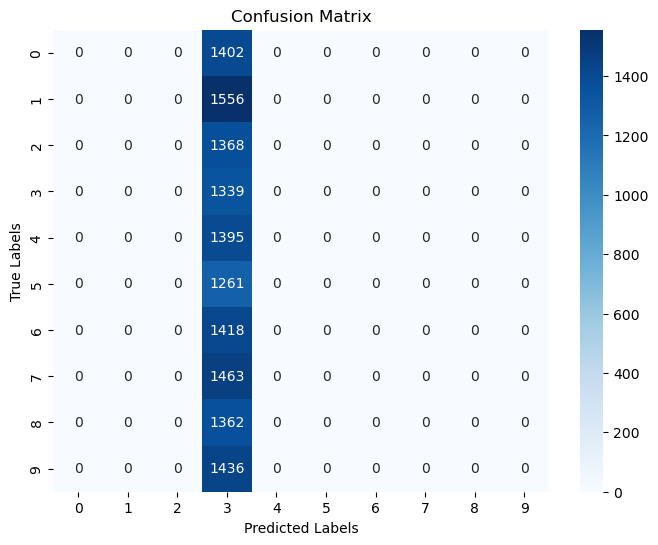

In [27]:
validate_model(model4, y_val_encoded, y_val_pred4, y_val_pred_proba4, label_encoder)

## 5. Uniform Xavier Initialization

In [23]:
model5 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="xavier", type="uniform", loss_function="cce", seed=42)

# model training
history5 = model5.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 1.3256 - val_loss: 0.5818
Epoch 2/20 - loss: 0.4532 - val_loss: 0.4334
Epoch 3/20 - loss: 0.3446 - val_loss: 0.3900
Epoch 4/20 - loss: 0.2882 - val_loss: 0.3495
Epoch 5/20 - loss: 0.2490 - val_loss: 0.3277
Epoch 6/20 - loss: 0.2229 - val_loss: 0.3097
Epoch 7/20 - loss: 0.2022 - val_loss: 0.2998
Epoch 8/20 - loss: 0.1844 - val_loss: 0.2854
Epoch 9/20 - loss: 0.1711 - val_loss: 0.2776
Epoch 10/20 - loss: 0.1591 - val_loss: 0.2710
Epoch 11/20 - loss: 0.1486 - val_loss: 0.2674
Epoch 12/20 - loss: 0.1401 - val_loss: 0.2641
Epoch 13/20 - loss: 0.1324 - val_loss: 0.2543
Epoch 14/20 - loss: 0.1245 - val_loss: 0.2578
Epoch 15/20 - loss: 0.1189 - val_loss: 0.2455
Epoch 16/20 - loss: 0.1132 - val_loss: 0.2461
Epoch 17/20 - loss: 0.1080 - val_loss: 0.2475
Epoch 18/20 - loss: 0.1032 - val_loss: 0.2455
Epoch 19/20 - loss: 0.0995 - val_loss: 0.2452
Epoch 20/20 - loss: 0.0950 - val_loss: 0.2436


In [28]:
model5.visualize_weight_distribution()
model5.visualize_gradient_weight_distribution()
model5.visualize_loss_curve()

In [29]:
predictions5 = model5.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels5 = np.argmax(predictions5, axis=1)
true_labels5 = np.argmax(y_val, axis=1)

In [30]:
y_val_pred5 = np.argmax(predictions5, axis=1) 
y_val_pred_proba5 = predictions5

Weighted F1-Score: 0.9456
Macro F1-Score: 0.9450
Cohen's Kappa: 0.9395
ROC-AUC (Weighted): 0.9965

Validation Log Loss: 0.2436

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1402
           1       0.98      0.98      0.98      1556
           2       0.92      0.95      0.94      1368
           3       0.92      0.93      0.93      1339
           4       0.96      0.93      0.95      1395
           5       0.94      0.93      0.93      1261
           6       0.97      0.96      0.96      1418
           7       0.96      0.94      0.95      1463
           8       0.93      0.93      0.93      1362
           9       0.91      0.92      0.92      1436

    accuracy                           0.95     14000
   macro avg       0.95      0.95      0.95     14000
weighted avg       0.95      0.95      0.95     14000




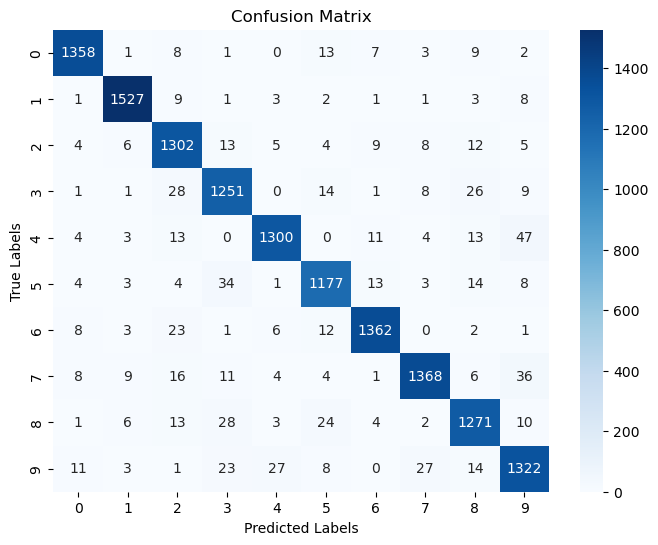

In [31]:
validate_model(model5, y_val_encoded, y_val_pred5, y_val_pred_proba5, label_encoder)

## 6. Normal He Initialization

In [32]:
model6 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="he", type="normal", loss_function="cce", seed=42)

# model training
history6 = model6.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 1.5949 - val_loss: 0.5533
Epoch 2/20 - loss: 0.4467 - val_loss: 0.4129
Epoch 3/20 - loss: 0.3393 - val_loss: 0.3631
Epoch 4/20 - loss: 0.2848 - val_loss: 0.3322
Epoch 5/20 - loss: 0.2507 - val_loss: 0.3156
Epoch 6/20 - loss: 0.2248 - val_loss: 0.2993
Epoch 7/20 - loss: 0.2056 - val_loss: 0.2926
Epoch 8/20 - loss: 0.1906 - val_loss: 0.2846
Epoch 9/20 - loss: 0.1773 - val_loss: 0.2735
Epoch 10/20 - loss: 0.1664 - val_loss: 0.2696
Epoch 11/20 - loss: 0.1576 - val_loss: 0.2639
Epoch 12/20 - loss: 0.1499 - val_loss: 0.2600
Epoch 13/20 - loss: 0.1432 - val_loss: 0.2538
Epoch 14/20 - loss: 0.1361 - val_loss: 0.2573
Epoch 15/20 - loss: 0.1309 - val_loss: 0.2511
Epoch 16/20 - loss: 0.1257 - val_loss: 0.2470
Epoch 17/20 - loss: 0.1202 - val_loss: 0.2538
Epoch 18/20 - loss: 0.1163 - val_loss: 0.2546
Epoch 19/20 - loss: 0.1123 - val_loss: 0.2421
Epoch 20/20 - loss: 0.1079 - val_loss: 0.2458


In [33]:
model6.visualize_weight_distribution()
model6.visualize_gradient_weight_distribution()
model6.visualize_loss_curve()

In [34]:
predictions6 = model6.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels6 = np.argmax(predictions6, axis=1)
true_labels6 = np.argmax(y_val, axis=1)

In [35]:
y_val_pred6 = np.argmax(predictions6, axis=1) 
y_val_pred_proba6 = predictions6

Weighted F1-Score: 0.9433
Macro F1-Score: 0.9428
Cohen's Kappa: 0.9370
ROC-AUC (Weighted): 0.9961

Validation Log Loss: 0.2458

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.96      0.96      1402
           1       0.97      0.99      0.98      1556
           2       0.94      0.94      0.94      1368
           3       0.93      0.91      0.92      1339
           4       0.94      0.93      0.94      1395
           5       0.92      0.95      0.94      1261
           6       0.97      0.95      0.96      1418
           7       0.95      0.94      0.94      1463
           8       0.93      0.95      0.94      1362
           9       0.92      0.91      0.92      1436

    accuracy                           0.94     14000
   macro avg       0.94      0.94      0.94     14000
weighted avg       0.94      0.94      0.94     14000




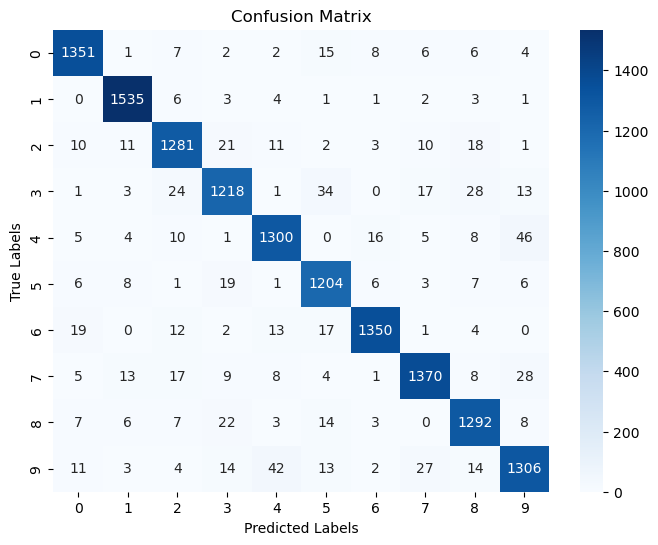

In [36]:
validate_model(model6, y_val_encoded, y_val_pred6, y_val_pred_proba6, label_encoder)

## 7. Uniform He Initialization

In [37]:
model7 = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="he", type="uniform", loss_function="cce", seed=42)

# model training
history7 = model7.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=20,
    verbose=1
)

Epoch 1/20 - loss: 1.5405 - val_loss: 0.7603
Epoch 2/20 - loss: 0.5973 - val_loss: 0.5592
Epoch 3/20 - loss: 0.4538 - val_loss: 0.4516
Epoch 4/20 - loss: 0.3776 - val_loss: 0.4081
Epoch 5/20 - loss: 0.3272 - val_loss: 0.3895
Epoch 6/20 - loss: 0.2905 - val_loss: 0.3581
Epoch 7/20 - loss: 0.2640 - val_loss: 0.3286
Epoch 8/20 - loss: 0.2425 - val_loss: 0.3143
Epoch 9/20 - loss: 0.2242 - val_loss: 0.3085
Epoch 10/20 - loss: 0.2107 - val_loss: 0.2979
Epoch 11/20 - loss: 0.1976 - val_loss: 0.2968
Epoch 12/20 - loss: 0.1870 - val_loss: 0.2796
Epoch 13/20 - loss: 0.1764 - val_loss: 0.2781
Epoch 14/20 - loss: 0.1684 - val_loss: 0.2725
Epoch 15/20 - loss: 0.1611 - val_loss: 0.2686
Epoch 16/20 - loss: 0.1542 - val_loss: 0.2606
Epoch 17/20 - loss: 0.1484 - val_loss: 0.2559
Epoch 18/20 - loss: 0.1428 - val_loss: 0.2597
Epoch 19/20 - loss: 0.1390 - val_loss: 0.2500
Epoch 20/20 - loss: 0.1329 - val_loss: 0.2513


In [38]:
model7.visualize_weight_distribution()
model7.visualize_gradient_weight_distribution()
model7.visualize_loss_curve()

In [39]:
predictions7 = model7.predict(X_val)

# convert one-hot predictions back to labels
predicted_labels7 = np.argmax(predictions7, axis=1)
true_labels7 = np.argmax(y_val, axis=1)

In [40]:
y_val_pred7 = np.argmax(predictions7, axis=1) 
y_val_pred_proba7 = predictions7

Weighted F1-Score: 0.9385
Macro F1-Score: 0.9377
Cohen's Kappa: 0.9316
ROC-AUC (Weighted): 0.9960

Validation Log Loss: 0.2513

Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97      1402
           1       0.97      0.98      0.98      1556
           2       0.90      0.96      0.93      1368
           3       0.94      0.90      0.92      1339
           4       0.95      0.92      0.94      1395
           5       0.90      0.94      0.92      1261
           6       0.95      0.95      0.95      1418
           7       0.96      0.93      0.95      1463
           8       0.94      0.90      0.92      1362
           9       0.91      0.93      0.92      1436

    accuracy                           0.94     14000
   macro avg       0.94      0.94      0.94     14000
weighted avg       0.94      0.94      0.94     14000




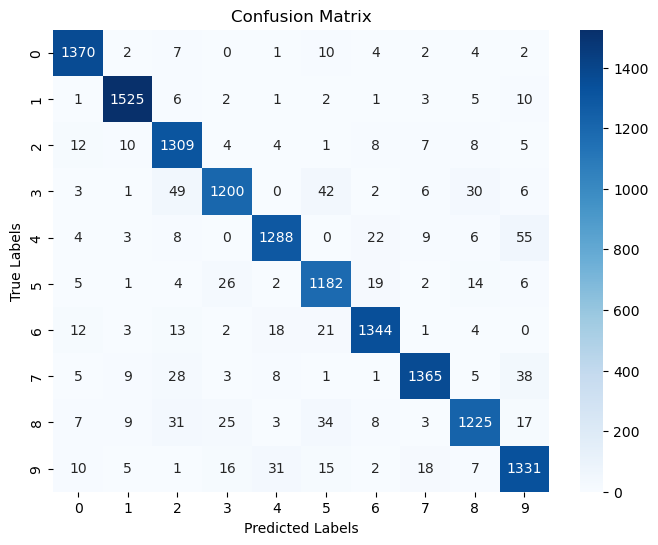

In [41]:
validate_model(model7, y_val_encoded, y_val_pred7, y_val_pred_proba7, label_encoder)